<a href="https://www.kaggle.com/code/klyushnik/playground-serie-for-the-first-time?scriptVersionId=168375159" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/playground-series-s3e3/sample_submission.csv
/kaggle/input/playground-series-s3e3/train.csv
/kaggle/input/playground-series-s3e3/test.csv


In [2]:
sample_submission = pd.read_csv('/kaggle/input/playground-series-s3e3/sample_submission.csv')

test = pd.read_csv('/kaggle/input/playground-series-s3e3/test.csv')

train = pd.read_csv('/kaggle/input/playground-series-s3e3/train.csv')

In [3]:
import pandas_profiling
import matplotlib.pyplot as plt

In [4]:
pandas_profiling.ProfileReport(train)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
train['BusinessTravel'] = train['BusinessTravel'].map(lambda x: x.lower())
train['Department'] = train['Department'].map(lambda x: x.lower())
train['EducationField'] = train['EducationField'].map(lambda x: x.lower())
train['Gender'] = train['Gender'].map(lambda x: x.lower())
train['JobRole'] = train['JobRole'].map(lambda x: x.lower())
train['MaritalStatus'] = train['MaritalStatus'].map(lambda x: x.lower())
train['Over18'] = train['Over18'].map(lambda x: x.lower())
train['OverTime'] = train['OverTime'].map(lambda x: x.lower())


test['BusinessTravel'] = test['BusinessTravel'].map(lambda x: x.lower())
test['Department'] = test['Department'].map(lambda x: x.lower())
test['EducationField'] = test['EducationField'].map(lambda x: x.lower())
test['Gender'] = test['Gender'].map(lambda x: x.lower())
test['JobRole'] = test['JobRole'].map(lambda x: x.lower())
test['MaritalStatus'] = test['MaritalStatus'].map(lambda x: x.lower())
test['Over18'] = test['Over18'].map(lambda x: x.lower())
test['OverTime'] = test['OverTime'].map(lambda x: x.lower())


In [6]:
cat_features = [
    'BusinessTravel',
    'Department',
    'EducationField',
    'Gender', 
    'JobRole',
    'MaritalStatus', 
    'Over18',
    'OverTime'
]

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)

In [8]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

In [9]:
X = train[[
    'Age', 'DailyRate', 'DistanceFromHome',
    'Education', 'EmployeeCount', 'EnvironmentSatisfaction',
    'HourlyRate',  'JobInvolvement', 'JobLevel',  
    'JobSatisfaction',  'MonthlyIncome',  'MonthlyRate', 
    'NumCompaniesWorked', 'PercentSalaryHike',  'PerformanceRating',
    'RelationshipSatisfaction', 'StandardHours', 'StockOptionLevel',
    'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
    'YearsAtCompany',  'YearsInCurrentRole', 'YearsSinceLastPromotion', 'YearsWithCurrManager']]
y = train[['Attrition']]

bestfeatures = SelectKBest(score_func = chi2, k = 'all')
fit = bestfeatures.fit(X, y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

featureScores = pd.concat([dfcolumns, dfscores], axis = 1)
featureScores.columns = ['Specs', 'Score']  
print(featureScores.nlargest(10, 'Score')) 

                   Specs         Score
10         MonthlyIncome  88990.666702
11           MonthlyRate    172.644436
18     TotalWorkingYears    158.561251
21        YearsAtCompany    137.721170
1              DailyRate    131.874833
22    YearsInCurrentRole     92.502452
0                    Age     87.293158
24  YearsWithCurrManager     79.628012
17      StockOptionLevel     52.012539
8               JobLevel     18.525082


In [10]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import Image
%matplotlib inline

<Figure size 800x640 with 0 Axes>

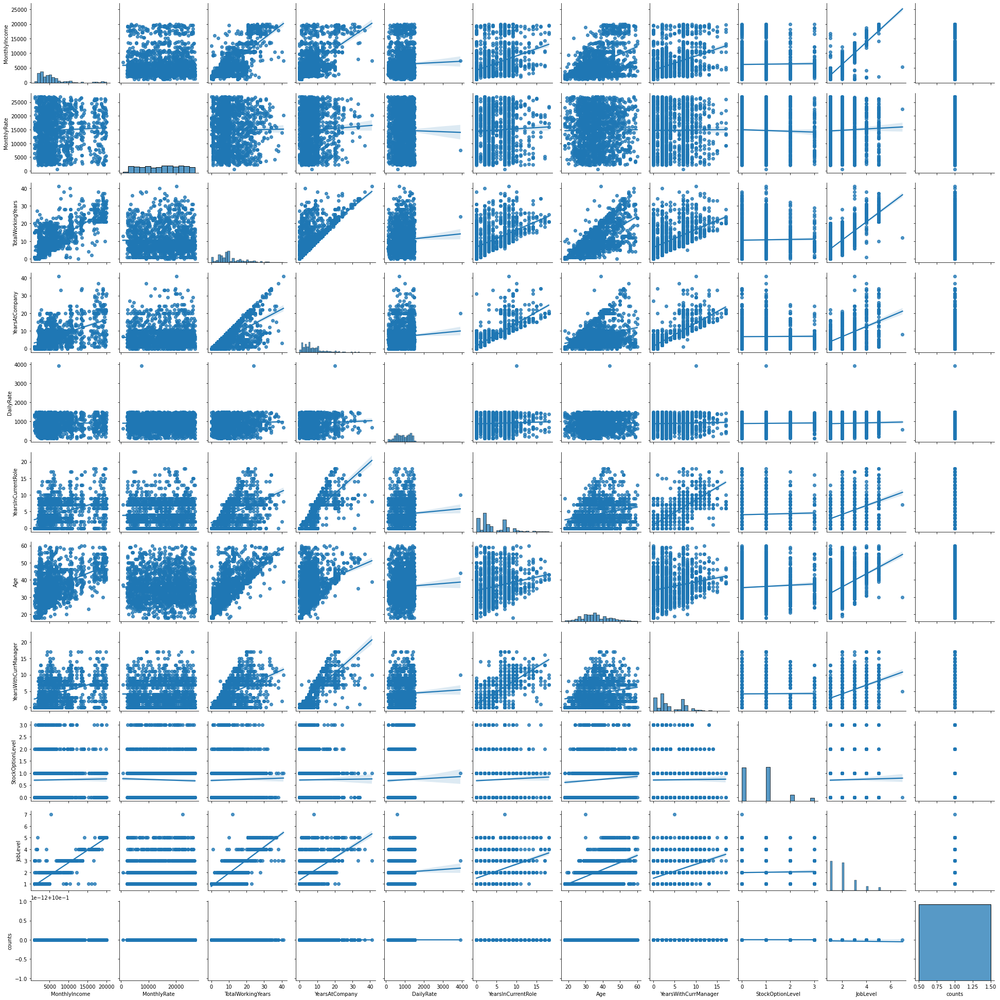

In [11]:
df = train.groupby(['MonthlyIncome','MonthlyRate', 'TotalWorkingYears' ,  'YearsAtCompany',
            'DailyRate', 'YearsInCurrentRole', 'Age', 'YearsWithCurrManager',
            'StockOptionLevel', 'JobLevel']).size().reset_index(name='counts')
 
plt.figure(figsize=(10,8), dpi= 80)
sns.pairplot(df, kind="reg")
plt.show()

In [12]:
df_train = train.copy(deep =True)

df_test = test.copy(deep = True)

In [13]:
from sklearn.preprocessing import OrdinalEncoder
enc = OrdinalEncoder()
enc.fit(df_train[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']])
df_train[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']] = enc.transform(df_train[['BusinessTravel',
                                                       'Department',
                                                       'EducationField',
                                                       'Gender', 
                                                       'JobRole',
                                                       'MaritalStatus',
                                                       'Over18',
                                                       'OverTime']])

enc.fit(df_test[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']])
df_test[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']] = enc.transform(df_test[['BusinessTravel',
                                                       'Department',
                                                       'EducationField',
                                                       'Gender', 
                                                       'JobRole',
                                                       'MaritalStatus',
                                                       'Over18',
                                                       'OverTime']])

In [14]:
X = df_train.drop(columns = ['Attrition'])
y = df_train.Attrition




from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.45, random_state=42)

In [15]:
import os
np.set_printoptions(precision=4)
import catboost
from catboost import *
from catboost import datasets

In [16]:
from catboost import CatBoostClassifier

In [17]:
clf = CatBoostClassifier(
    iterations=200,
    random_seed=42,
    learning_rate=0.5,
    custom_loss=['AUC', 'Accuracy']
)

clf.fit(
    X_train, y_train,
    #cat_features=cat_features,
    eval_set=(X_test, y_test),
    verbose=False,
    plot=True
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [18]:
from catboost.utils import get_roc_curve
import sklearn
from sklearn import metrics

eval_pool = Pool(X_test, y_test)# cat_features=cat_features)
curve = get_roc_curve(clf, eval_pool)
(fpr, tpr, thresholds)=curve
roc_auc=sklearn.metrics.auc(fpr, tpr)

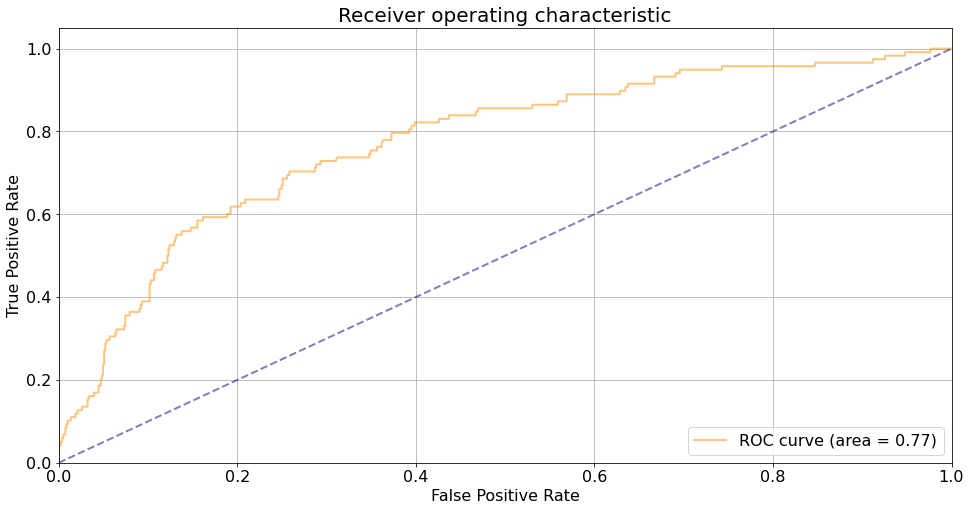

In [19]:
plt.figure(figsize=(16, 8))
lw=2

plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc, alpha=0.5)

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('False Positive Rate', fontsize=16)
plt.ylabel('True Positive Rate', fontsize=16)
plt.title('Receiver operating characteristic', fontsize=20)
plt.legend(loc="lower right", fontsize=16)
plt.show()

In [20]:
from catboost.utils import get_fpr_curve
from catboost.utils import get_fnr_curve

(thresholds, fpr) = get_fpr_curve(curve=curve)
(thresholds, fnr) = get_fnr_curve(curve=curve)

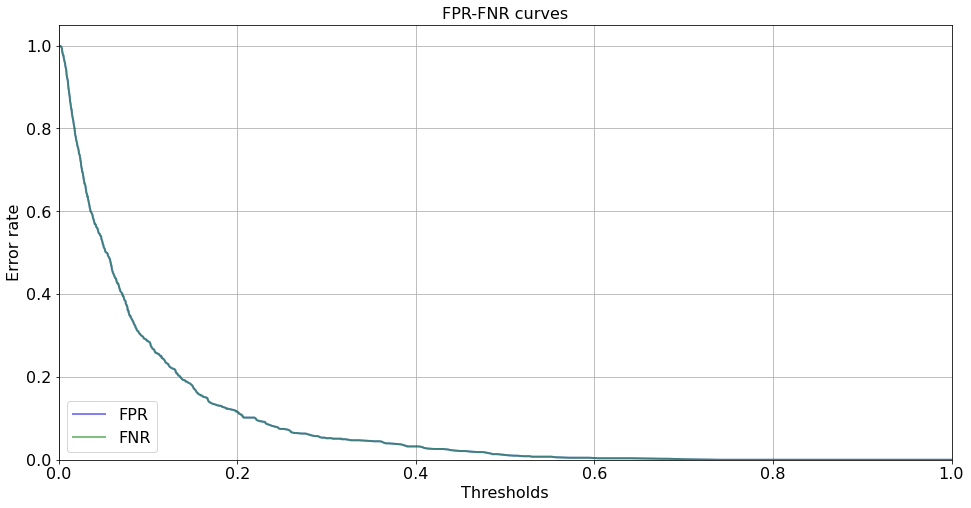

In [21]:
plt.figure(figsize=(16, 8))
lw=2

plt.plot(thresholds, fpr, color='blue', lw=lw, label='FPR', alpha=0.5)
plt.plot(thresholds, fpr, color='green', lw=lw, label='FNR', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('Thresholds', fontsize=16)
plt.ylabel('Error rate', fontsize=16)
plt.title('FPR-FNR curves', fontsize=16)
plt.legend(loc='lower left', fontsize=16)
plt.show()

In [22]:
from catboost.utils import select_threshold

print(select_threshold(model=clf, data=eval_pool, FNR=0.01))
print(select_threshold(model=clf, data=eval_pool, FPR=0.01))

0.007637013613264123
0.5097886661476498


In [23]:
from catboost import CatBoostClassifier

tunned_model = CatBoostClassifier(
    random_seed=63,
    iterations=50,
    learning_rate=0.01,
    l2_leaf_reg=3,
    bagging_temperature=1,
    random_strength=1,
    one_hot_max_size=2,
    leaf_estimation_method='Newton',
    custom_loss=['AUC', 'Accuracy']    
)

tunned_model.fit(
    X_train, y_train,
    #cat_features=cat_features,
    verbose=False,
    eval_set=(X_test, y_test),
    plot=True

)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [24]:
tunned_model.get_feature_importance(prettified=True)

,Feature Id,Importances
0,StockOptionLevel,14.679044
1,MaritalStatus,8.698537
2,MonthlyIncome,7.836830
3,JobLevel,7.634497
4,JobRole,5.544446
5,YearsWithCurrManager,3.714111
6,JobInvolvement,3.633644
7,RelationshipSatisfaction,3.469462
8,OverTime,3.334507
9,YearsAtCompany,3.293053


In [25]:
import shap

explainer = shap.TreeExplainer(tunned_model)
shap_values=explainer.shap_values(Pool(X, y)) #, cat_features=cat_features)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_values[3,:], X.iloc[3,:])

In [26]:
import shap
shap.initjs()
shap.force_plot(explainer.expected_value,shap_values[91, :], X.iloc[91, :])

In [27]:
X_small = X.iloc[0:200]
shap_small = shap_values[:200]
shap.force_plot(explainer.expected_value, shap_small, X_small)

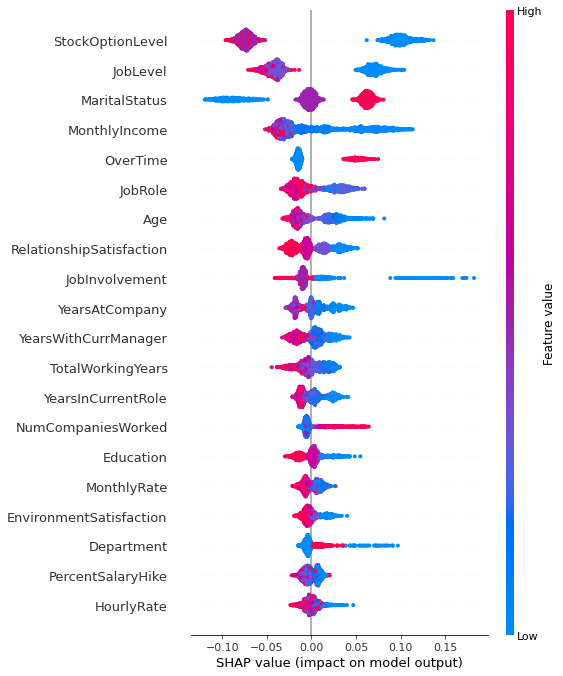

In [28]:
shap.summary_plot(shap_values, X)

In [29]:
eval_pool = Pool(X_test, y_test)#, cat_features=cat_features)
curve = get_roc_curve(tunned_model, eval_pool)
(fpr, tpr, thresholds)=curve
roc_auc=sklearn.metrics.auc(fpr, tpr)

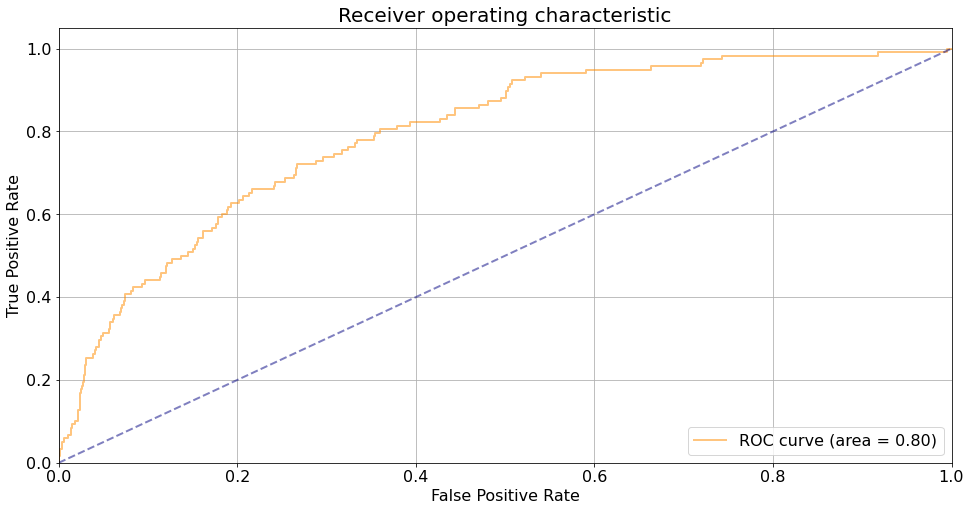

In [30]:
plt.figure(figsize=(16, 8))
lw=2

plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc, alpha=0.5)

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('False Positive Rate', fontsize=16)
plt.ylabel('True Positive Rate', fontsize=16)
plt.title('Receiver operating characteristic', fontsize=20)
plt.legend(loc="lower right", fontsize=16)
plt.show()

In [31]:
clf = CatBoostClassifier(
    random_seed=63,
    iterations=int(tunned_model.tree_count_ * 2.2)
)

clf.fit(
    X, y,
    #cat_features=cat_features,
    verbose=100
)

Learning rate set to 0.097242
0:	learn: 0.6021952	total: 3.54ms	remaining: 385ms
100:	learn: 0.1099366	total: 222ms	remaining: 19.8ms
109:	learn: 0.0996535	total: 244ms	remaining: 0us


In [32]:
eval_pool = Pool(X_test, y_test)#, cat_features=cat_features)
curve = get_roc_curve(clf, eval_pool)
(fpr, tpr, thresholds)=curve
roc_auc=sklearn.metrics.auc(fpr, tpr)

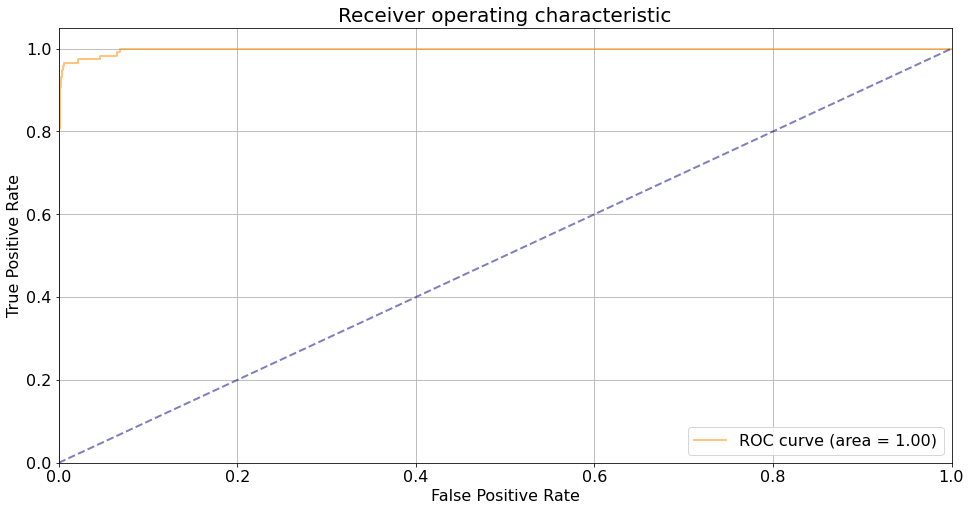

In [33]:
plt.figure(figsize=(16, 8))
lw=2

plt.plot(fpr, tpr, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc, alpha=0.5)

plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--', alpha=0.5)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.grid(True)
plt.xlabel('False Positive Rate', fontsize=16)
plt.ylabel('True Positive Rate', fontsize=16)
plt.title('Receiver operating characteristic', fontsize=20)
plt.legend(loc="lower right", fontsize=16)
plt.show()

In [34]:
X_total = df_test
total_pool = Pool(X_total)#, cat_features=cat_features)
predictions=clf.predict(total_pool)
print(f"Predictions: {predictions}")

Predictions: [0 0 0 ... 0 0 0]


In [35]:
clfs = []

clfs.append(clf)

In [36]:
ans_train = df_train.copy()
ans_test = df_test.copy()

In [37]:
from sklearn.preprocessing import OrdinalEncoder
enc = OrdinalEncoder()
enc.fit(ans_train[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']])
ans_train[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']] = enc.transform(ans_train[['BusinessTravel',
                                                       'Department',
                                                       'EducationField',
                                                       'Gender', 
                                                       'JobRole',
                                                       'MaritalStatus',
                                                       'Over18',
                                                       'OverTime']])

enc.fit(ans_test[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']])
ans_test[['BusinessTravel',
                   'Department',
                   'EducationField',
                   'Gender', 
                   'JobRole',
                   'MaritalStatus',
                   'Over18',
                   'OverTime']] = enc.transform(ans_test[['BusinessTravel',
                                                       'Department',
                                                       'EducationField',
                                                       'Gender', 
                                                       'JobRole',
                                                       'MaritalStatus',
                                                       'Over18',
                                                       'OverTime']])

In [38]:
X = ans_train.drop(columns = ['Attrition'])
y = ans_train.Attrition

In [39]:
from sklearn.model_selection import  GridSearchCV
import lightgbm as lgb
from tqdm import tqdm
from sklearn.metrics import (roc_curve, auc, accuracy_score)

In [40]:
params = {
    'application': 'binary', # for binary classification
#     'num_class' : 1, # used for multi-classes
    'boosting': 'gbdt', # traditional gradient boosting decision tree
    'num_iterations': 100, 
    'learning_rate': 0.05,
    'num_leaves': 62,
    'device': 'cpu', # you can use GPU to achieve faster learning
    'max_depth': -1, # <0 means no limit
    'max_bin': 510, # Small number of bins may reduce training accuracy but can deal with over-fitting
    'lambda_l1': 5, # L1 regularization
    'lambda_l2': 10, # L2 regularization
    'metric' : 'binary_error',
    'subsample_for_bin': 200, # number of samples for constructing bins
    'subsample': 1, # subsample ratio of the training instance
    'colsample_bytree': 0.8, # subsample ratio of columns when constructing the tree
    'min_split_gain': 0.5, # minimum loss reduction required to make further partition on a leaf node of the tree
    'min_child_weight': 1, # minimum sum of instance weight (hessian) needed in a leaf
    'min_child_samples': 5# minimum number of data needed in a leaf
}

mdl = lgb.LGBMClassifier(boosting_type= 'gbdt', 
          objective = 'binary', 
          n_jobs = 5, 
          max_depth = params['max_depth'],
          max_bin = params['max_bin'], 
          subsample_for_bin = params['subsample_for_bin'],
          subsample = params['subsample'], 
          min_split_gain = params['min_split_gain'], 
          min_child_weight = params['min_child_weight'], 
          min_child_samples = params['min_child_samples'])

mdl.get_params().keys()

dict_keys(['boosting_type', 'class_weight', 'colsample_bytree', 'importance_type', 'learning_rate', 'max_depth', 'min_child_samples', 'min_child_weight', 'min_split_gain', 'n_estimators', 'n_jobs', 'num_leaves', 'objective', 'random_state', 'reg_alpha', 'reg_lambda', 'silent', 'subsample', 'subsample_for_bin', 'subsample_freq', 'max_bin'])

In [41]:
gridParams = {
    'learning_rate': [0.005, 0.01],
    'n_estimators': [8,16,24],
    'num_leaves': [6,8,12,16], # large num_leaves helps improve accuracy but might lead to over-fitting
    'boosting_type' : ['gbdt', 'dart'], # for better accuracy -> try dart
    'objective' : ['binary'],
    'max_bin':[255, 510], # large max_bin helps improve accuracy but might slow down training progress
    'random_state' : [500],
    'colsample_bytree' : [0.64, 0.65, 0.66],
    'subsample' : [0.7,0.75],
    'reg_alpha' : [1,1.2],
    'reg_lambda' : [1,1.2,1.4],
    }

grid = GridSearchCV(mdl, gridParams, verbose=1, cv=4, n_jobs=-1)
# Run the grid
grid.fit(X, y)

# Print the best parameters found
print(grid.best_params_)
print(grid.best_score_)

Fitting 4 folds for each of 3456 candidates, totalling 13824 fits
{'boosting_type': 'gbdt', 'colsample_bytree': 0.64, 'learning_rate': 0.005, 'max_bin': 255, 'n_estimators': 8, 'num_leaves': 6, 'objective': 'binary', 'random_state': 500, 'reg_alpha': 1, 'reg_lambda': 1, 'subsample': 0.7}
0.8807392885555176


In [42]:
lgbm_params = {'boosting_type': 'gbdt', 
               'colsample_bytree': 0.64, 
               'learning_rate': 0.005, 
               'max_bin': 255,
               'n_estimators': 8, 
               'num_leaves': 6, 
               'objective': 'binary',
               'random_state': 500,
               'reg_alpha': 1, 
               'reg_lambda': 1, 
               'subsample': 0.7}


clf = lgb.LGBMClassifier(**lgbm_params)

clf.fit(X,y)

lgb_pred = clf.predict(ans_test)

In [43]:
lgb_preds = clf.predict_proba(ans_test)[:,1]
clfs.append(clf)

In [44]:
X = ans_train.drop(columns = ['Attrition'])
y = ans_train.Attrition

from xgboost import XGBClassifier

In [45]:
clf = XGBClassifier(n_estimators= 150,
                 max_depth = 3,
                 learning_rate= 0.1,
                 min_child_weight= 4,
                 subsample= 0.7,
                 colsample_bytree= 0.3)

clf.fit(X, y)

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.3,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
              importance_type=None, interaction_constraints='',
              learning_rate=0.1, max_bin=256, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=3, max_leaves=0, min_child_weight=4,
              missing=nan, monotone_constraints='()', n_estimators=150,
              n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, ...)

In [46]:
xgb_preds = clf.predict_proba(ans_test)[:,1]
clfs.append(clf)

In [47]:
xgb_preds

array([0.1388, 0.0551, 0.03  , ..., 0.0126, 0.0203, 0.0037], dtype=float32)

In [48]:
from sklearn.ensemble import  GradientBoostingClassifier

Accuracy of the GBM on test set: 0.905
              precision    recall  f1-score   support

           0       0.93      0.96      0.95       307
           1       0.42      0.28      0.33        29

    accuracy                           0.90       336
   macro avg       0.68      0.62      0.64       336
weighted avg       0.89      0.90      0.90       336



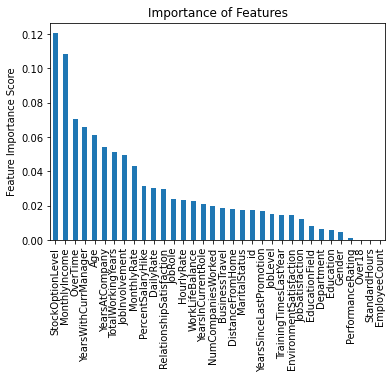

In [49]:
from sklearn.metrics import classification_report
from sklearn.model_selection import  GridSearchCV

X = ans_train.drop(columns = ['Attrition'])
y = ans_train.Attrition


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)


clf = GradientBoostingClassifier(learning_rate=0.1, n_estimators=100,max_depth=3, min_samples_split=2, min_samples_leaf=1, subsample=1,max_features='sqrt', random_state=10)
clf.fit(X_train,y_train)
predictors=list(X_train)
feat_imp = pd.Series(clf.feature_importances_, predictors).sort_values(ascending=False)
feat_imp.plot(kind='bar', title='Importance of Features')
plt.ylabel('Feature Importance Score')
print('Accuracy of the GBM on test set: {:.3f}'.format(clf.score(X_test, y_test)))
pred=clf.predict(X_test)
print(classification_report(y_test, pred))

In [50]:
gbclf_pred = clf.predict_proba(ans_test)[:,1]

clfs.append(clf)

In [51]:
X = ans_train.drop(columns = ['Attrition'])
y = ans_train.Attrition

In [52]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=100)

In [53]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, plot_confusion_matrix

In [54]:
knn = KNeighborsClassifier()
from sklearn.model_selection import GridSearchCV
k_range = list(range(1, 31))
param_grid = dict(n_neighbors=k_range)
  
# defining parameter range
grid = GridSearchCV(knn, param_grid, cv=10, scoring='accuracy', return_train_score=False,verbose=1)
  
# fitting the model for grid search
grid_search=grid.fit(x_train, y_train)

Fitting 10 folds for each of 30 candidates, totalling 300 fits


In [55]:
print(grid_search.best_params_)

{'n_neighbors': 12}


In [56]:
clf = KNeighborsClassifier(n_neighbors=12)

clf.fit(X, y)

KNeighborsClassifier(n_neighbors=12)

In [57]:
knn = clf.predict_proba(ans_test)[:,1]
clfs.append(clf)

In [58]:
clfs

 LGBMClassifier(colsample_bytree=0.64, learning_rate=0.005, max_bin=255,
                n_estimators=8, num_leaves=6, objective='binary',
                random_state=500, reg_alpha=1, reg_lambda=1, subsample=0.7),
 XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
               colsample_bylevel=1, colsample_bynode=1, colsample_bytree=0.3,
               early_stopping_rounds=None, enable_categorical=False,
               eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
               importance_type=None, interaction_constraints='',
               learning_rate=0.1, max_bin=256, max_cat_to_onehot=4,
               max_delta_step=0, max_depth=3, max_leaves=0, min_child_weight=4,
               missing=nan, monotone_constraints='()', n_estimators=150,
               n_jobs=0, num_parallel_tree=1, predictor='auto', random_state=0,
               reg_alpha=0, reg_lambda=1, ...),
 GradientBoostingClassifier(max_features='sqrt', random_state=10, subsample=1),


In [59]:
test_preds = []

for clf in clfs:
    preds = clf.predict_proba(ans_test)
    test_preds.append(preds[:, 1])
    
test_preds = np.stack(test_preds).mean(0)
test_preds

array([0.1766, 0.0996, 0.0776, ..., 0.0492, 0.0343, 0.1116])

In [60]:
submission = pd.DataFrame(data={'id': test.id, 'Attrition': test_preds})
submission.head()

,id,Attrition
0,1677,0.176644
1,1678,0.099620
2,1679,0.077599
3,1680,0.058201
4,1681,0.402403


In [61]:
submission.to_csv('submission.csv', index=False)